# Imports

In [1]:
import seaborn as sns
import matplotlib.pyplot as plt
import scanpy as sc
from matplotlib import rcParams
import gc
import glob

In [2]:
import warnings
warnings.filterwarnings("ignore")
rcParams['figure.figsize'] = (4, 3)

# Functions

In [3]:
def load_adata(suffix, model='reference_query_mapping', dataset='nanostring_cosmx_human_nsclc'):
    model_folder = glob.glob(f'../../../artifacts/{dataset}/models/{model}/*_{suffix}')[0]
    adata_path = f"{model_folder}/{dataset}_{model}.h5ad"
    adata = sc.read_h5ad(adata_path)
    return adata, adata_path

In [4]:
def plot_cluster_proportions(cluster_props, 
                             cluster_palette=None,
                             xlabel_rotation=0,
                             figsize=(9,4),
                             ax=None,
                             figs=None): 
    if ax is None:
        figs, ax = plt.subplots(figsize=figsize)
        figs.patch.set_facecolor("white")
        figs.tight_layout()
        
    cmap = None
    if cluster_palette is not None:
        cmap = sns.palettes.blend_palette(
            cluster_palette, 
            n_colors=len(cluster_palette), 
            as_cmap=True)    
   
    cluster_props.plot(
        kind="bar", 
        stacked=True, 
        ax=ax, 
        legend=None, 
        colormap=cmap
    )
    
    ax.legend(bbox_to_anchor=(1.01, 1), frameon=False, title="Cluster").remove()
    sns.despine(figs, ax)
    ax.tick_params(axis="x", rotation=xlabel_rotation)
    ax.tick_params(axis="y", rotation=90)
    ax.set_xlabel(cluster_props.index.name.capitalize())
    ax.set_ylabel("Proportion")

    return ax

In [5]:
def plot_latent(adata, model='reference_query_mapping'):
    
    # plot umap and spatial with general characteristics
    if model == 'reference_query_mapping':
        query = adata.obs.batch[adata.obs.mapping_entity=='query'].unique()[0]
        sc.pl.umap(adata, color=['mapping_entity','cell type', 'batch','niche'], ncols=4, wspace=0.5, size=0.5)
        sc.pl.embedding(adata[adata.obs.batch==query], basis="spatial", color=['cell type', 'niche'], ncols=2, wspace=0.5, size=1)
        
    elif model == 'reference':
        sc.pl.umap(adata, color=['batch','cell type','niche'], ncols=3, wspace=0.5, size=0.5)

    # plot clusters
    cluster_res = adata.obs.columns[adata.obs.columns.str.contains('latent_leiden_')]
    sc.pl.umap(adata, color=cluster_res, ncols=4, wspace=0.5, size=0.5)
    
    if model == 'reference_query_mapping':
        sc.pl.embedding(adata[adata.obs.batch==query], basis="spatial", color=cluster_res, ncols=4, wspace=0.5, size=1)    
        
    return

In [6]:
def res_details(adata, resolution=0.4, model='reference_query_mapping'):

    # plot spatial for all samples
    fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(18, 6))
    for i, batch in enumerate(adata.obs.batch.unique()):
        if i < 4:
            sc.pl.embedding(adata[adata.obs.batch==batch], basis="spatial", color=f'latent_leiden_{resolution}', size=1, show=False, ax=axes[0,i], title=batch)
        else:
            sc.pl.embedding(adata[adata.obs.batch==batch], basis="spatial", color=f'latent_leiden_{resolution}', size=1, show=False, ax=axes[1,i-4], title=batch)
    plt.tight_layout()
    plt.show()
    
    # plot proportions
    figs, axes = plt.subplots(nrows=1, ncols=3, figsize=(18, 3))
    plot_var = f'latent_leiden_{resolution}'
    
    for i, cluster_var in enumerate(['cell type', 'niche', 'batch']):
        props = adata.obs.groupby([cluster_var, plot_var]).size().reset_index()
        props = props.pivot(columns=plot_var, index=cluster_var).T
        props.index = props.index.droplevel(0)
        props.fillna(0, inplace=True)
        props = props.div(props.sum(axis=1), axis=0)*100 
        axes[i] = plot_cluster_proportions(props, xlabel_rotation=90, cluster_palette=adata.uns[f'{cluster_var}_colors'], figsize=(4,3), ax=axes[i], figs=figs)
    figs.show()

    return

# Reference 43
no contrastive, L1 0 add on, 1000 masked, decrease kl x10, 0.03 active GPs

## Select resolution

### reference

In [10]:
adata, adata_path = load_adata(suffix='43', model='reference')

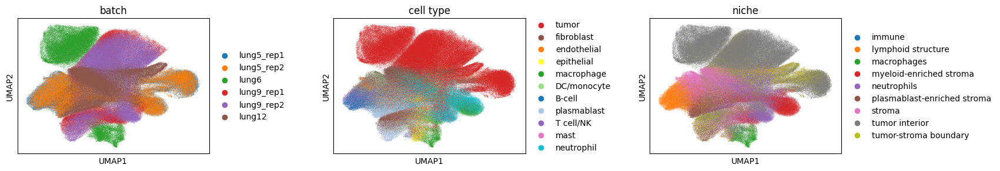

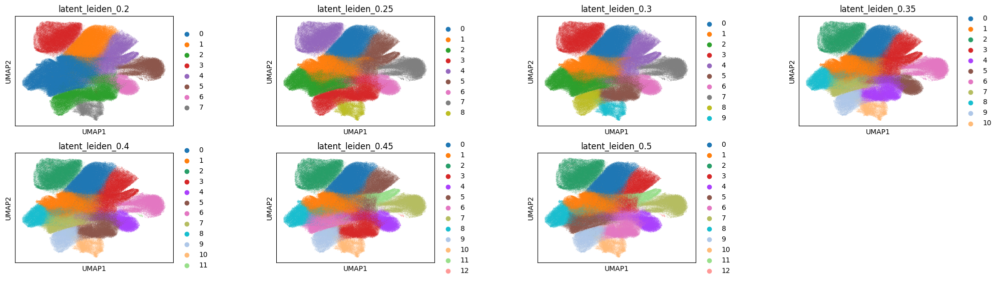

In [11]:
plot_latent(adata, model='reference')

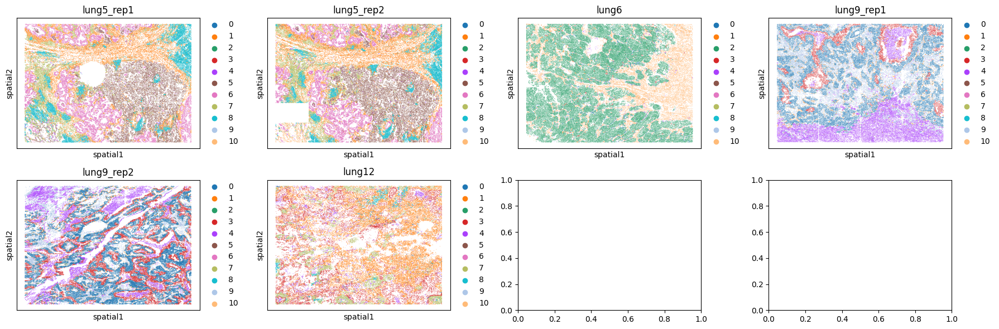

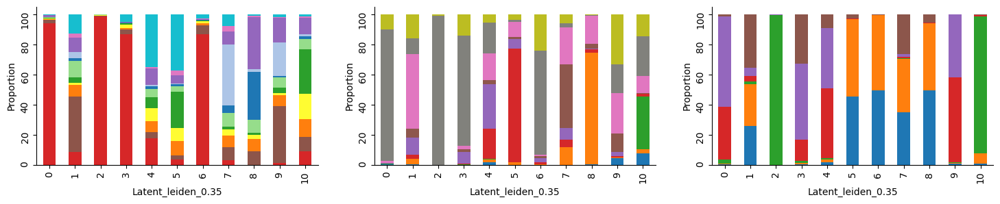

In [17]:
latent_leiden_resolution=0.35
res_details(adata, resolution=latent_leiden_resolution, model='reference')

In [25]:
adata.uns['cluster_groups'] = {}
adata.uns['cluster_groups'][f"latent_leiden_{latent_leiden_resolution}"] = {
    'tumor_clusters': ['0','2', '3', '6'],
    'stroma_clusters': ['1', '9'],
    'neutrophil_clusters': ['4', '5'],
    'macrophage_clusters': ['10'],
    'lymphoid_clusters': ['7', '8', '9']
}

65607

### reference + r3

In [8]:
adata, adata_path = load_adata(suffix='43_3', model='reference_query_mapping')

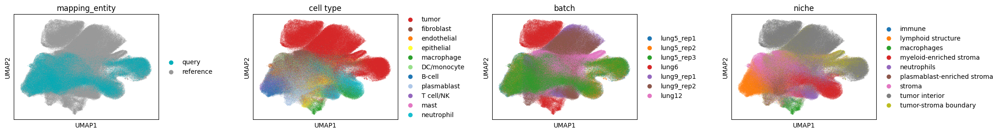

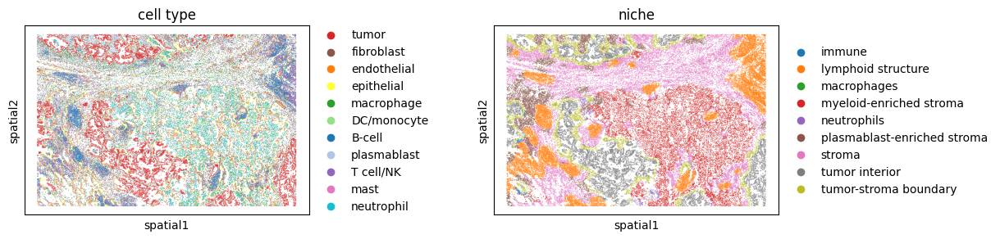

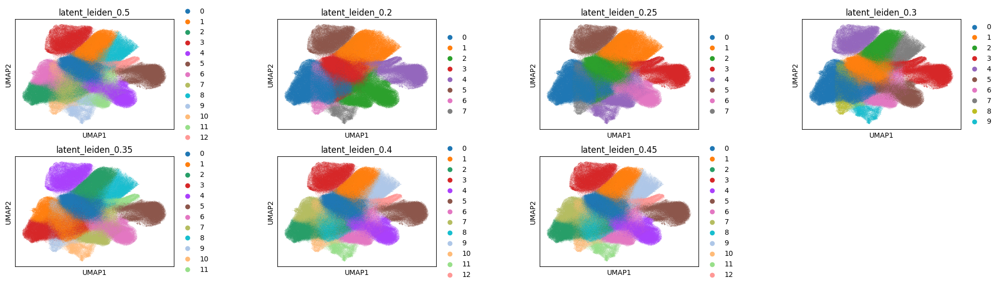

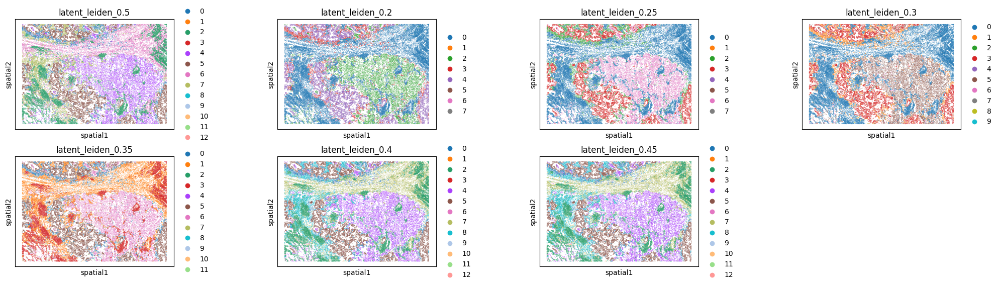

In [9]:
plot_latent(adata, model='reference_query_mapping')

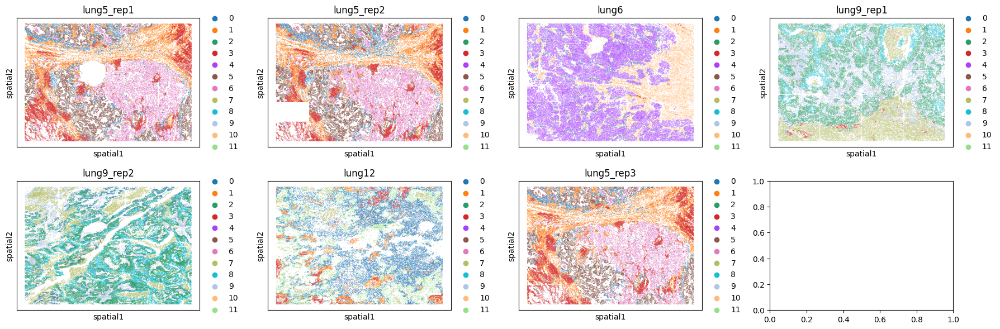

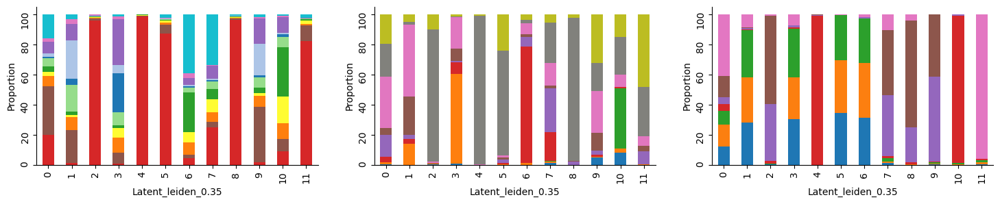

In [10]:
latent_leiden_resolution=0.35
res_details(adata, resolution=latent_leiden_resolution, model='reference_query_mapping')

In [11]:
adata.uns['cluster_groups'] = {}
adata.uns['cluster_groups'][f"latent_leiden_{latent_leiden_resolution}"] = {
    'tumor_clusters': ['2','4','5','8','11'],
    'stroma_clusters': ['0','1'],
    'neutrophil_clusters': ['6','7'],
    'macrophage_clusters': ['10'],
    'lymphoid_clusters': ['3','9']
}

In [12]:
adata.write_h5ad(adata_path)
del adata
gc.collect()

95923

### reference + s13

In [13]:
adata, adata_path = load_adata(suffix='43_8', model='reference_query_mapping')

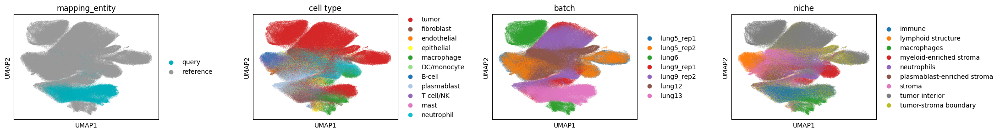

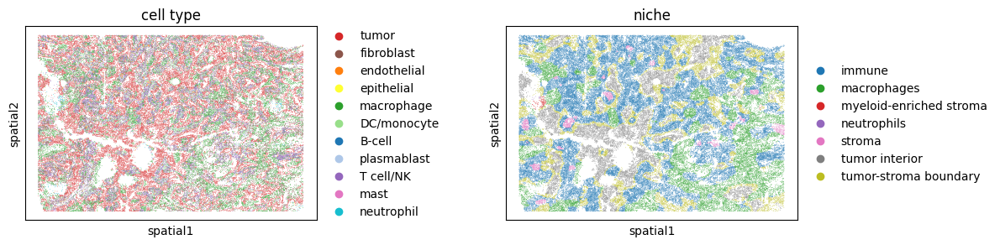

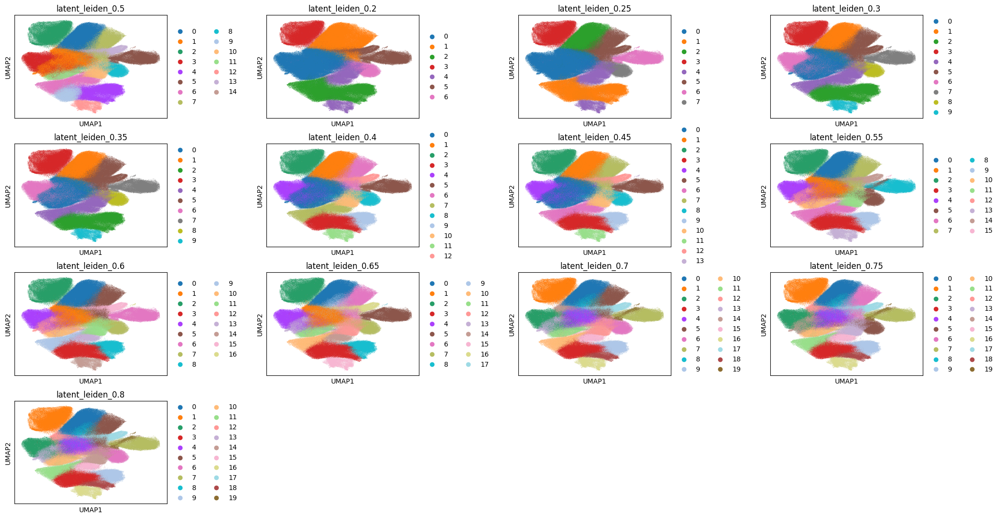

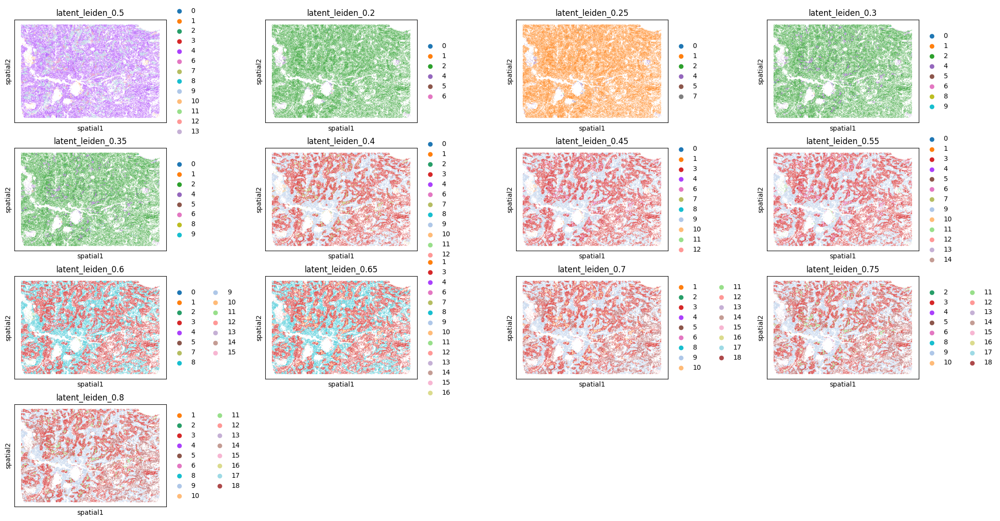

In [7]:
plot_latent(adata, model='reference_query_mapping')

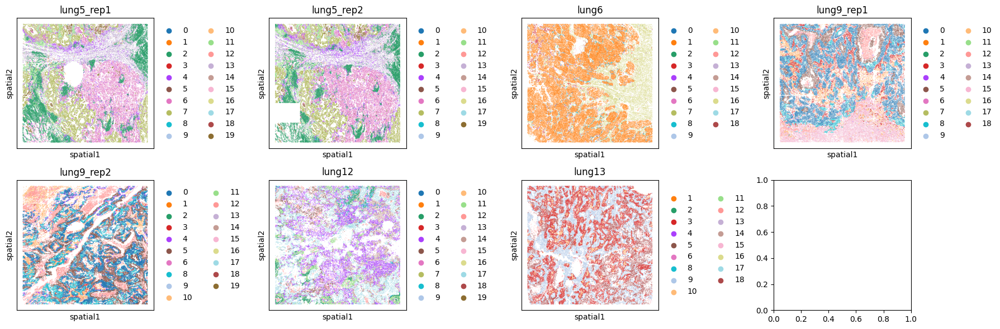

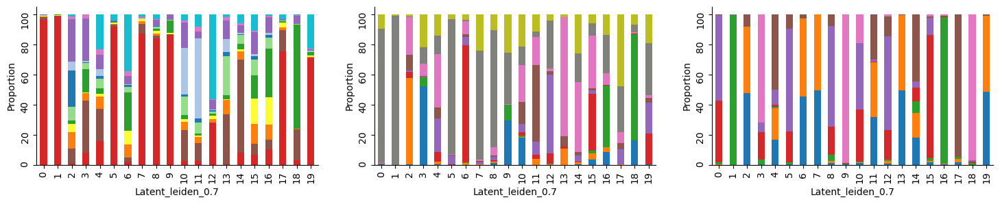

In [14]:
latent_leiden_resolution=0.7
res_details(adata, resolution=latent_leiden_resolution, model='reference_query_mapping')

In [18]:
adata.uns['cluster_groups'] = {}
adata.uns['cluster_groups'][f"latent_leiden_{latent_leiden_resolution}"] = {
    'tumor_clusters': [],
    'stroma_clusters': [],
    'neutrophil_clusters': [],
    'macrophage_clusters': [],
    'lymphoid_clusters': []
}

In [19]:
adata.write_h5ad(adata_path)
del adata
gc.collect()

71912

# Reference 49
no contrastive, L1 0 add on, 1000 masked, decrease kl x10, 0.03 active GPs

## Select resolution

### reference

In [9]:
adata, adata_path = load_adata(suffix='49', model='reference')

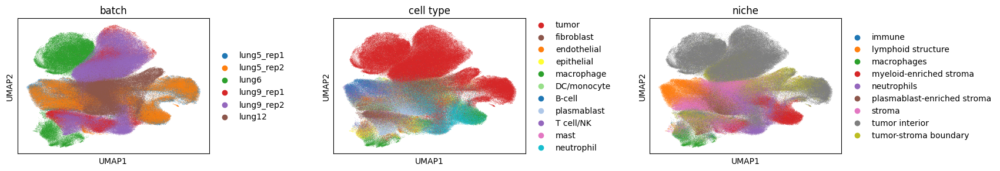

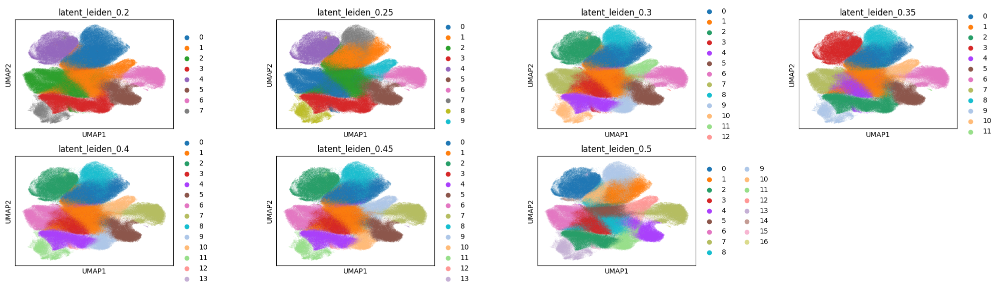

In [10]:
plot_latent(adata, model='reference')

In [ ]:
latent_leiden_resolution=0.4
res_details(adata, resolution=latent_leiden_resolution, model='reference')

In [ ]:
adata.uns['cluster_groups'] = {}
adata.uns['cluster_groups'][f"latent_leiden_{latent_leiden_resolution}"] = {
    'tumor_clusters': [],
    'stroma_clusters': [],
    'neutrophil_clusters': [],
    'macrophage_clusters': [],
    'lymphoid_clusters': []
}

In [18]:
# adata.write_h5ad(adata_path)
del adata
gc.collect()

87410

### reference + r3

In [16]:
adata, adata_path = load_adata(suffix='49_3', model='reference_query_mapping')

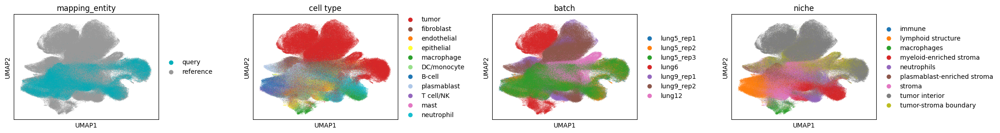

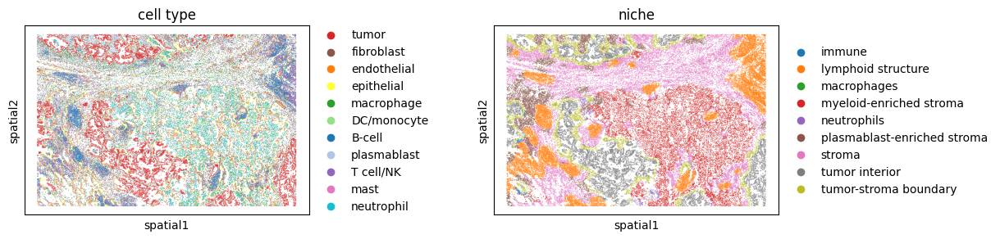

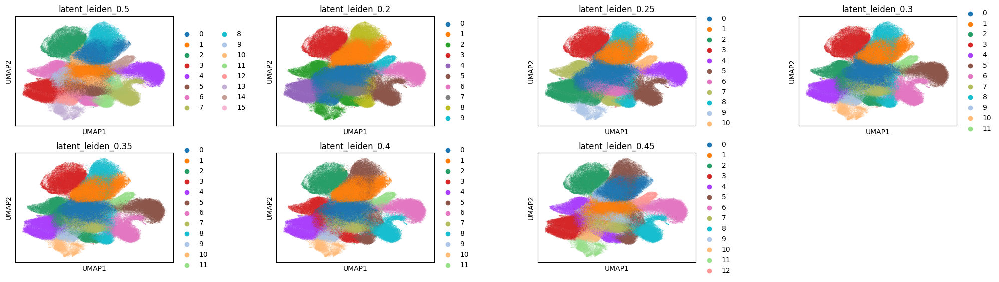

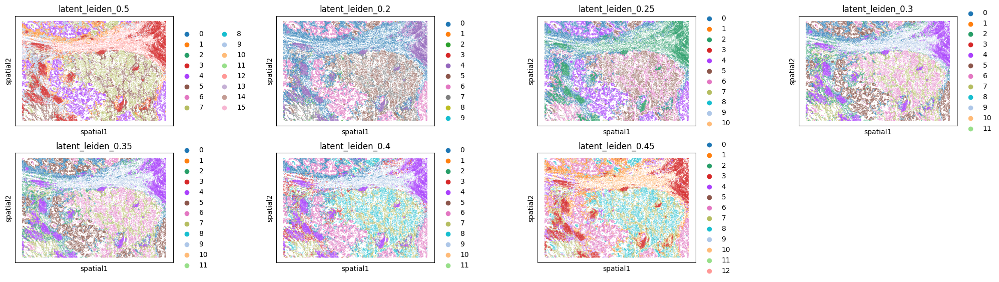

In [17]:
plot_latent(adata, model='reference_query_mapping')

In [ ]:
latent_leiden_resolution=0.4
res_details(adata, resolution=latent_leiden_resolution, model='reference_query_mapping')

In [ ]:
adata.uns['cluster_groups'] = {}
adata.uns['cluster_groups'][f"latent_leiden_{latent_leiden_resolution}"] = {
    'tumor_clusters': [],
    'stroma_clusters': [],
    'neutrophil_clusters': [],
    'macrophage_clusters': []
}

adata.write_h5ad(adata_path)
del adata
gc.collect()

### reference + s13

In [19]:
adata, adata_path = load_adata(suffix='49_8', model='reference_query_mapping')

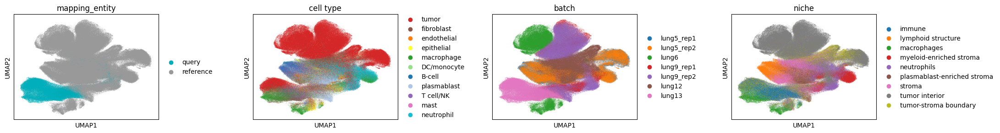

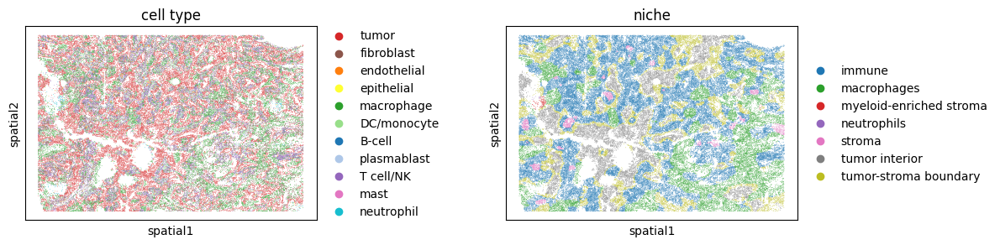

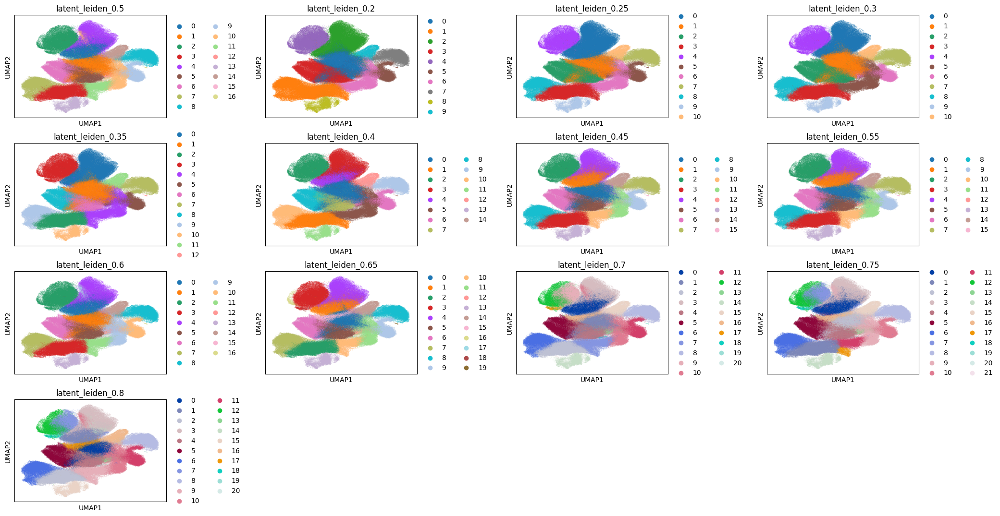

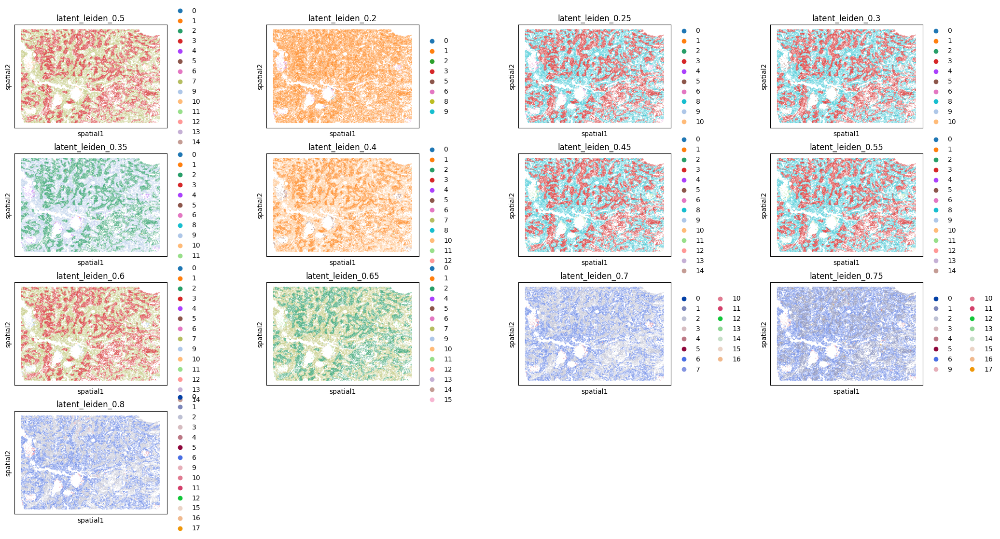

In [20]:
plot_latent(adata, model='reference_query_mapping')

In [ ]:
latent_leiden_resolution=0.4
res_details(adata, resolution=latent_leiden_resolution, model='reference_query_mapping')

In [ ]:
adata.uns['cluster_groups'] = {}
adata.uns['cluster_groups'][f"latent_leiden_{latent_leiden_resolution}"] = {
    'tumor_clusters': [],
    'stroma_clusters': [],
    'neutrophil_clusters': [],
    'macrophage_clusters': [],
    'lymphoid_clusters': []
}

In [ ]:
adata.write_h5ad(adata_path)
del adata
gc.collect()